# The Basics to Quantum Computing

## Description
We'll be talking about the underlying <u>mathematical</u> and <u>computer science</u> concepts that come with the field of Quantum Computing. The physics portions of this field becomes more prevalent in the real-world implementations of qubits and quantum gates and will not be discussed in these notebooks.

## Technology
These notebooks will be using [Qiskit](https://qiskit.org/), a library developed by IBM and free to anyone to use to explore and utilize Quantum Simulators and Computers for research and experiments. These notebooks also use MatPlotLib to draw quantum circuits in a much more colorful way.

In [1]:
import math

from qiskit import Aer, QuantumCircuit, IBMQ
from qiskit.visualization import plot_histogram
from qiskit.quantum_info import Statevector
from qiskit.tools.monitor import job_monitor
from qiskit.tools.visualization import plot_bloch_multivector, visualize_transition
%matplotlib inline

### Setting up account credentials
This is used to iteract with IBM's Quantum Computers using a registered account on their website.

#### *Disclaimer*
Anyone wanting to use this feature needs to make an account [here](https://quantum-computing.ibm.com/) and needs to alter the `IBMQ.save_account()` function appropriately.

In [2]:
IBMQ.save_account(open("../API_key.txt","r").read(), overwrite=True)
IBMQ.load_account()

<AccountProvider for IBMQ(hub='ibm-q', group='open', project='main')>

## Needed Concepts

### Mathematical Notations

#### Bra-Ket
The Bra-Ket notation is used to calculate the probabilities of each state.

For any given state $\left| \psi \right\rangle$ of a single qubit, the equation for any state is expressed as such: $\alpha\left| 0 \right\rangle + \beta\left| 1 \right\rangle$ where
- $\alpha, \beta \in \mathbb{C}$
    - Alpha and beta are complex numbers: $a + bi$
- $|\alpha|^2 + |\beta|^2 = 1$
    - Where 1 means 100% total probability

##### Squared Magnitude
The equation: $|\mathbb{C}| = |a + bi|^2 = a^2 + b^2$

##### The Bloch Sphere equation
For any given state $\left| \psi \right\rangle$ of a single qubit, the equation can also be expressed as $\cos\big(\frac \theta 2\big)\left| 0 \right\rangle + e^{i\phi}\sin\big(\frac \theta 2\big)\left| 1 \right\rangle$ where
- The Euler Identity: $e^{i\phi} = \cos(\phi) + i\sin(\phi)$
- The domain of our variables are
    - $\theta$: $[0, \pi]$
    - $\phi$: $[0, 2\pi]$

##### Visualization
<div>
<img src="color-online-Bloch-sphere-representation-of-the-Bloch-vector-v-for-qubits-d-2.png" width="400"/>
</div>

*Point* $v$ *denotes the current state of the qubit, and it can be rotated to any other point on the surface of the sphere*

##### Why do we need a sphere to represent a qubit? Couldn't we just use a circle?
In some situations, we do use a circle because they're helpful for explaining **just** the superposition of a qubit.

<div>
<img src="Unit-Circle.png" width="300"/>
</div>


*Here is a unit circle commonly used for explaning the basics to angles in trigonometry. In Quantum Computing, we use this as a sort of state diagram to show changes between qubit states*

- For example, we can go from (1,0) to another point like (-1,0) using a quantum gate, and then we can use the same quantum gate to go back to (1,0)
    - To move to other locations, we can chain different quantum gates together
    - [This video](https://youtu.be/F_Riqjdh2oM?list=TLPQMjcxMjIwMjK6wylWUK_zFg&t=1743) presents the 'state machine' idea a bit more clearly

#### Matrix
The state of $\left| \psi \right\rangle$ can be represented in a $2\times1$ matrix known as the <u>state vector</u>, which is shown as 
$$
\begin{bmatrix}
\alpha\\
\beta
\end{bmatrix}
$$

where $\alpha$ and $\beta$ are the same complex numbers from the [Bra-Ket notation](#Bra-Ket).
<br>
<br>
The state vector is used a majority of the time because we describe Quantum Gates as $2\times2$ matrices that alter the state of the qubit via matrix multiplication for single-qubit operations.

### Technical Terms

#### Common States Vectors
These are shorthanded symbols for the most frequently used state vectors
##### Deterministic States
- $\left| 0 \right\rangle = 1\left| 0 \right\rangle + 0\left| 1 \right\rangle = \begin{bmatrix}
1\\
0
\end{bmatrix}$
- $\left| 1 \right\rangle = 0\left| 0 \right\rangle + 1\left| 1 \right\rangle = \begin{bmatrix}
0\\
1
\end{bmatrix}$

##### 50/50 Superposed States
- $\left| + \right\rangle = \frac 1 {\sqrt 2}\left| 0 \right\rangle + \frac 1 {\sqrt 2}\left| 1 \right\rangle = \frac 1 {\sqrt 2}\begin{bmatrix}
1\\
1
\end{bmatrix}$
- $\left| - \right\rangle = \frac 1 {\sqrt 2}\left| 0 \right\rangle - \frac 1 {\sqrt 2}\left| 1 \right\rangle = \frac 1 {\sqrt 2}\begin{bmatrix}
1\\
-1
\end{bmatrix}$
- $\left| i \right\rangle = \frac 1 {\sqrt 2}\left| 0 \right\rangle + \frac i {\sqrt 2}\left| 1 \right\rangle = \frac 1 {\sqrt 2}\begin{bmatrix}
1\\
i
\end{bmatrix}$
- $\left| -i \right\rangle = \frac 1 {\sqrt 2}\left| 0 \right\rangle - \frac i {\sqrt 2}\left| 1 \right\rangle = \frac 1 {\sqrt 2}\begin{bmatrix}
1\\
-i
\end{bmatrix}$

#### Tensor Product
***Definition***: A special type of matrix multiplication where, using matrices $U$ and $V$, we multiply every number in matrix $U$ to every number in matrix $V$.
- **Notation**: $U \otimes V$
- **Commutativity**: $U \otimes V \ne V \otimes U$

##### Example
We'll use state vectors since they're the most frequently used when conducting tensor products. Let's say that matrix $U = \left| 0 \right\rangle = 
\begin{bmatrix}
1\\
0
\end{bmatrix}$ and $V = \left| 1 \right\rangle = 
\begin{bmatrix}
0\\
1
\end{bmatrix}$

</br>
$$\begin{bmatrix}
1\\
0
\end{bmatrix}
\otimes 
\begin{bmatrix}
0\\
1
\end{bmatrix} = 
\begin{bmatrix}
0\\
1\\
0\\
0
\end{bmatrix}$$
<br>
The $4\times 1$ matrix represents the state vector of the <u>whole system</u>, not just 2 individual state vectors. This comes into play for Quantum Gates that take in 2 qubits. Instead of $\left| 0 \right\rangle$ and $\left| 1 \right\rangle$, we have $\left| 00 \right\rangle$, $\left| 01 \right\rangle$, $\left| 10 \right\rangle$, $\left| 11 \right\rangle$ (starting at the top of the vector and going down) where we have a 1 on $\left| 01 \right\rangle$ in our example

- This new state vector must still obey the rule that, for a given state $\left| \psi \right\rangle = \alpha\left| 00 \right\rangle+\beta\left| 01 \right\rangle+\gamma\left| 10 \right\rangle+\lambda\left| 11 \right\rangle$, the sum of the [squared magnitudes](#Squared-Magnitude) of $\alpha$, $\beta$, $\gamma$, $\lambda$ must equal 1 or 100%
    - $|\alpha|^2 + |\beta|^2 + |\lambda|^2 + |\gamma|^2 = 1$

##### Explanation
A more general form for any 2 state vectors will look as such:
$\begin{bmatrix}
\alpha_1\\
\beta_1
\end{bmatrix}
\otimes 
\begin{bmatrix}
\alpha_2\\
\beta_2
\end{bmatrix} = 
\begin{bmatrix}
\alpha_1\alpha_2\\
\alpha_1\beta_2\\
\beta_1\alpha_2\\
\beta_1\beta_2
\end{bmatrix}$

#### Superposition
***Definition***: Any qubit state that is <u>non-deterministic</u>.
- The most common of these will be 50% $\left| 0 \right\rangle$ and 50% $\left| 1 \right\rangle$, which is outlined by [these states](#50/50-Superposed-States), but this can go as far 99.9% $\left| 0 \right\rangle$ and 0.1% $\left| 1 \right\rangle$ and beyond
    - The point is that, before measuring the qubit, we cannot determine its state beyond a "decent guess"

#### Entanglement
***Definition***: When 2 or more qubits are configured in such a manner that measuring one qubit will affect the measurements of the rest.
- Mathematically, we say that the state vector of an $N$-qubit system **cannot** be factored into a tensor product of individual qubits
- **Must have** 2 or more qubits for entanglement to take place
    - One qubit cannot be entangled with itself


## Quantum Gates
### Context

***Definition***: Quantum Gates apply some type of <u>reversible</u> rotation to the input qubit(s) so that the state of output is changed in some manner.
- Mathematically, gates are represented as an $2^N \times 2^N$ matrix where $N$ is the number of qubits the gate takes in as input
- These matrices have a few properties
    - All gates are <u>Unitary</u>
        - This means that for a given <u>square matrix</u> $U$, the adjoint of that matrix is its inverse
            - $U^\dagger = U^{-1}$ such that $UU^\dagger = UU^{-1} = I$
        - The matrix **must** be an $N \times N$ (square) matrix because we cannot get the inverse of a non-square matrix, which we fulfill
        - This property of being unitary means that we can reverse the operation
    - Some gates are <u>Hermitian</u>
        - This means that for a given square matrix, the gate $U$ is its own adjoint
            - $U = U^{-1} = U^\dagger$
    - If the gate is not Hermitian, then the Quantum Gate $U$ will have a daggered gate $U^\dagger$
        - This gate is the adjoint of $U$

### The Not (X) Gate 

#### Diagrams
##### Standard Python

In [3]:
#Creating the Quantum Circuit with 1 qubit on it
not_circuit = QuantumCircuit(1)

# Appending an X gate to the circuit
not_circuit.x(0)

# Drawing the circuit
not_circuit.draw()

┌───┐
q: ┤ X ├
   └───┘

##### Using MatPlotLib

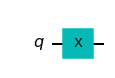

In [4]:
#Drawing the circuit using MatPlotLib
not_circuit.draw(output='mpl')

#### Description
**Context**: When applied to the state vector, it swaps the values of $\alpha$ and $\beta$
- This is a 1-qubit gate

#### Matrix Representation
$$
\begin{bmatrix}
0 & 1\\
1 & 0
\end{bmatrix}
$$

#### In Action
$$
\begin{bmatrix}
0 & 1\\
1 & 0
\end{bmatrix}
\begin{bmatrix}
\alpha\\
\beta
\end{bmatrix}
 = 
\begin{bmatrix}
\beta\\
\alpha
\end{bmatrix}
$$

$$
\begin{bmatrix}
0 & 1\\
1 & 0
\end{bmatrix}
\begin{bmatrix}
\beta\\
\alpha
\end{bmatrix}
 = 
\begin{bmatrix}
\alpha\\
\beta
\end{bmatrix}
$$

#### Bloch Sphere Animation
**Context**: Here, we're going from $\left| 0 \right\rangle$ to $\left| 1 \right\rangle$. Notice that we're rotating along the $x$-axis.

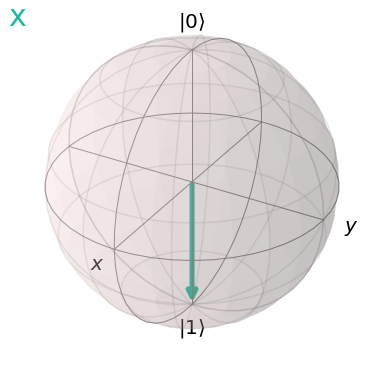

In [5]:
visualize_transition(not_circuit)

### Hadamard (H) Gate
#### Diagrams

##### Standard Python

In [6]:
hadamard_circuit = QuantumCircuit(1)
hadamard_circuit.h(0)

hadamard_circuit.draw()

┌───┐
q: ┤ H ├
   └───┘

##### Using MatPlotLib

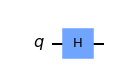

In [7]:
hadamard_circuit.draw(output='mpl')

#### Description
**Context**: When applied to the state vector, this gate puts qubits into and takes them out of [superposition](#Superposition).

#### Matrix Representation
$$
\frac {1}{\sqrt2}
\begin{bmatrix}
1 & 1\\
1 & -1
\end{bmatrix}
$$

#### In Action

$$
\frac {1}{\sqrt2}
\begin{bmatrix}
1 & 1\\
1 & -1
\end{bmatrix}
\begin{bmatrix}
1\\
0
\end{bmatrix}
 = 
\frac {1}{\sqrt2}
\begin{bmatrix}
1\\
1
\end{bmatrix}
$$

$$
\frac {1}{\sqrt2}
\begin{bmatrix}
1 & 1\\
1 & -1
\end{bmatrix}
\bigg(
\frac {1}{\sqrt2}
\begin{bmatrix}
1\\
1
\end{bmatrix}
\bigg)
=
\frac {1}{2}
\begin{bmatrix}
2\\
0
\end{bmatrix}
=
\begin{bmatrix}
1\\
0
\end{bmatrix}
$$

#### Bloch Sphere Animation
**Context**: The state vector rotates from  $\left| 0 \right\rangle$ to the $x$-axis or $\left| + \right\rangle$ in a strange way. This is because the H Gate does a rotation on the $x$-axis like the X Gate, but also does a counter rotation on $y$-axis at the same time.

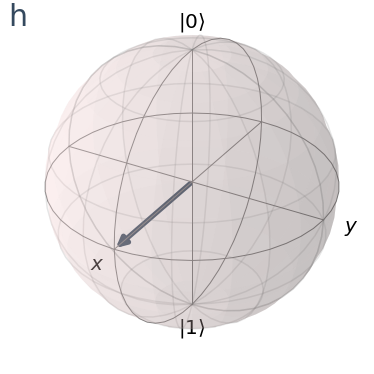

In [8]:
visualize_transition(hadamard_circuit)

### The Z Gate
#### Diagrams

##### Standard Python

In [9]:
z_circuit = QuantumCircuit(1)
z_circuit.z(0)


z_circuit.draw()

┌───┐
q: ┤ Z ├
   └───┘

##### Using MatPlotLib

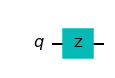

In [10]:
z_circuit.draw(output='mpl')

#### Description
**Context**: The Z Gate acts similarly to the X Gate in the sense that it simply rotates the qubit along its respective axis, but this rotation along the $z$-axis will **only** alter the <u>phase</u> of the qubit, it **does not** change the probabilities of the state vector.
#### Matrix Representation
$$
\begin{bmatrix}
1 & 0\\
0 & -1
\end{bmatrix}
$$

#### In Action
$$
\begin{bmatrix}
1 & 0\\
0 & -1
\end{bmatrix}
\bigg(
\begin{bmatrix}
1\\
0
\end{bmatrix}
\bigg)
=
\begin{bmatrix}
1\\
0
\end{bmatrix}
$$

$$
\begin{bmatrix}
1 & 0\\
0 & -1
\end{bmatrix}
\bigg(
\frac {1}{\sqrt2}
\begin{bmatrix}
1\\
1
\end{bmatrix}
\bigg)
=
\frac {1}{\sqrt2}
\begin{bmatrix}
1\\
-1
\end{bmatrix}
$$

#### Bloch Sphere Animation
**Context**: To see the Z Gate's effect on the qubit state more clearly, we put the qubit through an H Gate first so that we can see the rotation along the $z$-axis. This way, we're going from from $\left| 0 \right\rangle$ to $\left| + \right\rangle$ from the H Gate finally to $\left| - \right\rangle$ because of the Z Gate

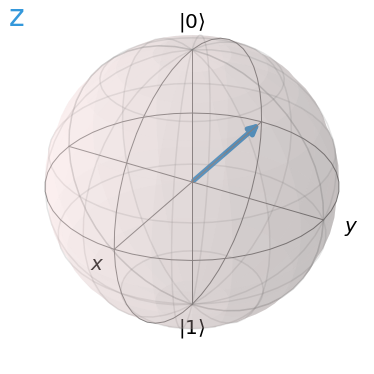

In [11]:
z_circuit = QuantumCircuit(1)
z_circuit.h(0)
z_circuit.z(0)

visualize_transition(z_circuit)

### Controlled Not (C-Not) Gate
#### Diagrams

##### Standard Python

In [12]:
cnot_circuit = QuantumCircuit(2)
cnot_circuit.cnot(0, 1)
cnot_circuit.barrier()
cnot_circuit.cnot(1, 0)

cnot_circuit.draw()

░ ┌───┐
q_0: ──■───░─┤ X ├
     ┌─┴─┐ ░ └─┬─┘
q_1: ┤ X ├─░───■──
     └───┘ ░

##### Using MatPlotLib

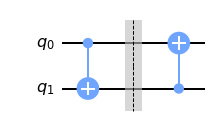

In [13]:
cnot_circuit.draw(output='mpl')

#### Description
**Context**: The C-Not Gate acts similar to its 1-qubit counterpart, but it requires one qubit to act as the <u>control</u> qubit. Whenever the control qubit has **any** chance of being $\left| 1 \right\rangle$, then the <u>target</u> qubit will be affected using a [Not Gate](#The-Not-(X)-Gate).

##### Adding controls to gates
- "Controls" can be added to any 1-qubit gate and the target qubit will be affected based on the particular gate is being used (i.e. C-Not: the target gets negated, CZ: the target gets affected using a Z Gate, etc.)
- A single-qubit gate can have one or many control qubits (with certain hardware limitations). The Toffoli Gate is an example of this. It's a 3-qubit gate that's also called the CC-Not gate, referring the 2 control qubits that it takes in


#### Matrix Representation
$$
\begin{bmatrix}
1 & 0 & 0 & 0\\
0 & 1 & 0 & 0\\
0 & 0 & 0 & 1\\
0 & 0 & 1 & 0
\end{bmatrix}
$$

#### In Action

$$
\begin{bmatrix}
1 & 0 & 0 & 0\\
0 & 1 & 0 & 0\\
0 & 0 & 0 & 1\\
0 & 0 & 1 & 0
\end{bmatrix}
\begin{bmatrix}
0\\
0\\
1\\
0
\end{bmatrix}
=
\begin{bmatrix}
0\\
0\\
0\\
1
\end{bmatrix}
$$

$$
\begin{bmatrix}
1 & 0 & 0 & 0\\
0 & 1 & 0 & 0\\
0 & 0 & 0 & 1\\
0 & 0 & 1 & 0
\end{bmatrix}
\begin{bmatrix}
0\\
0\\
0\\
1
\end{bmatrix}
=
\begin{bmatrix}
0\\
0\\
1\\
0
\end{bmatrix}
$$

#### Final Bloch Sphere States
***Context***: Since we can't animate the bloch sphere for multi-qubit operations, we'll just analyze the final state of the qubits

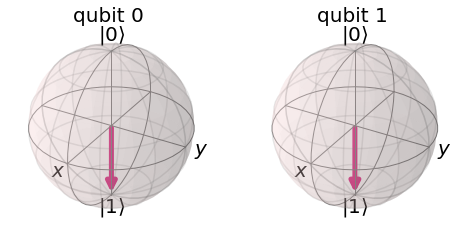

In [14]:
cnot_circuit = QuantumCircuit(2)
#Adding a not gate so that one qubit starts in state 1
cnot_circuit.x(0)

#Setting the first qubits as the control, the second as the target
cnot_circuit.cnot(0, 1)

state = Statevector(cnot_circuit)
plot_bloch_multivector(state)

### Swap Gate
#### Diagrams

##### Standard Python

In [15]:
swap_circuit = QuantumCircuit(2)

swap_circuit.swap(0, 1)
swap_circuit.draw()

q_0: ─X─
      │ 
q_1: ─X─

##### Using MatPlotLib

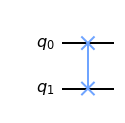

In [16]:
swap_circuit.draw(output='mpl')

#### Description
**Context**: The Swap Gate will swap the values for the states $\left| 01 \right\rangle$ and $\left| 10 \right\rangle$, leaving the other 2 states alone because swapping 0's and 1's around doesn't do anything.

#### Matrix Representation
$$
\begin{bmatrix}
1 & 0 & 0 & 0\\
0 & 0 & 1 & 0\\
0 & 1 & 0 & 0\\
0 & 0 & 0 & 1
\end{bmatrix}
$$

#### In Action
$$
\begin{bmatrix}
1 & 0 & 0 & 0\\
0 & 0 & 1 & 0\\
0 & 1 & 0 & 0\\
0 & 0 & 0 & 1
\end{bmatrix}
\bigg(
\frac {1}{\sqrt2}
\begin{bmatrix}
1\\
1\\
0\\
0
\end{bmatrix}
\bigg)
=
\frac {1}{\sqrt2}
\begin{bmatrix}
1\\
0\\
1\\
0
\end{bmatrix}
$$

##### General Form
$$
\begin{bmatrix}
1 & 0 & 0 & 0\\
0 & 0 & 1 & 0\\
0 & 1 & 0 & 0\\
0 & 0 & 0 & 1
\end{bmatrix}
\begin{bmatrix}
\alpha\\
\beta\\
\gamma\\
\lambda
\end{bmatrix}
=
\begin{bmatrix}
\alpha\\
\gamma\\
\beta\\
\lambda
\end{bmatrix}
$$

#### Final Bloch Sphere States

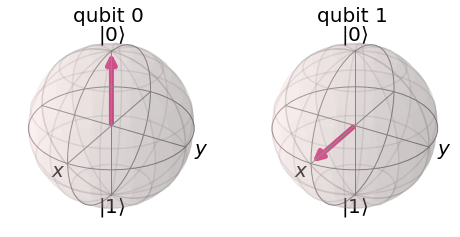

In [17]:
swap_circuit = QuantumCircuit(2)

swap_circuit.h(0)
swap_circuit.swap(0, 1)

state = Statevector(swap_circuit)
plot_bloch_multivector(state)